In [1]:
!pip install roboflow

In [2]:
!pip install ultralytics

In [3]:
!git clone https://github.com/abewley/sort.git

fatal: destination path 'sort' already exists and is not an empty directory.


In [ ]:
!pip install filterpy

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 178.0/178.0 kB 6.1 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for filterpy: filename=filterpy-1.4.5-py3-none-any.whl size=110460 sha256=fc7289576b29b1bd8a471d74060fde232d144475cf534e194edef0f8304f3e84
  Stored in directory: /root/.cache/pip/wheels/12/dc/3c/e12983eac132d00f82a20c6cbe7b42ce6e96190ef8fa2d15e1
Successfully built filterpy


# Download data

In [ ]:
from google.colab import files

uploaded = files.upload()

Saving sample.mp4 to sample.mp4


In [ ]:
from roboflow import Roboflow


rf = Roboflow(api_key="YOUR_API_KEY")

project = rf.workspace("roboflow-universe-projects").project("license-plate-recognition-rxg4e")
dataset = project.version(4).download("yolov8")

loading Roboflow workspace...
loading Roboflow project...



Extracting Dataset Version Zip to License-Plate-Recognition-4 in yolov8:: 100%|██████████| 48488/48488 [01:19<00:00, 607.22it/s] 


Creating new Ultralytics Settings v0.0.6 file  
View Ultralytics Settings with 'yolo settings' or at 'C:\Users\wine\AppData\Roaming\Ultralytics\settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


In [ ]:
import os

dataset_path = './License-Plate-Recognition-4'
os.listdir(dataset_path)

['data.yaml',
 'README.dataset.txt',
 'README.roboflow.txt',
 'test',
 'train',
 'valid']

In [ ]:
train_folder = os.path.join(dataset_path, 'train/images')
val_folder = os.path.join(dataset_path, 'valid/images')
test_folder = os.path.join(dataset_path, 'test/images')

num_train = len(os.listdir(train_folder))
num_val = len(os.listdir(val_folder))
num_test = len(os.listdir(test_folder))

print(f"Train dataset size: {num_train} images")
print(f"Validation dataset size: {num_val} images")
print(f"Test dataset size: {num_test} images")

Train dataset size: 21173 images
Validation dataset size: 2046 images
Test dataset size: 1019 images


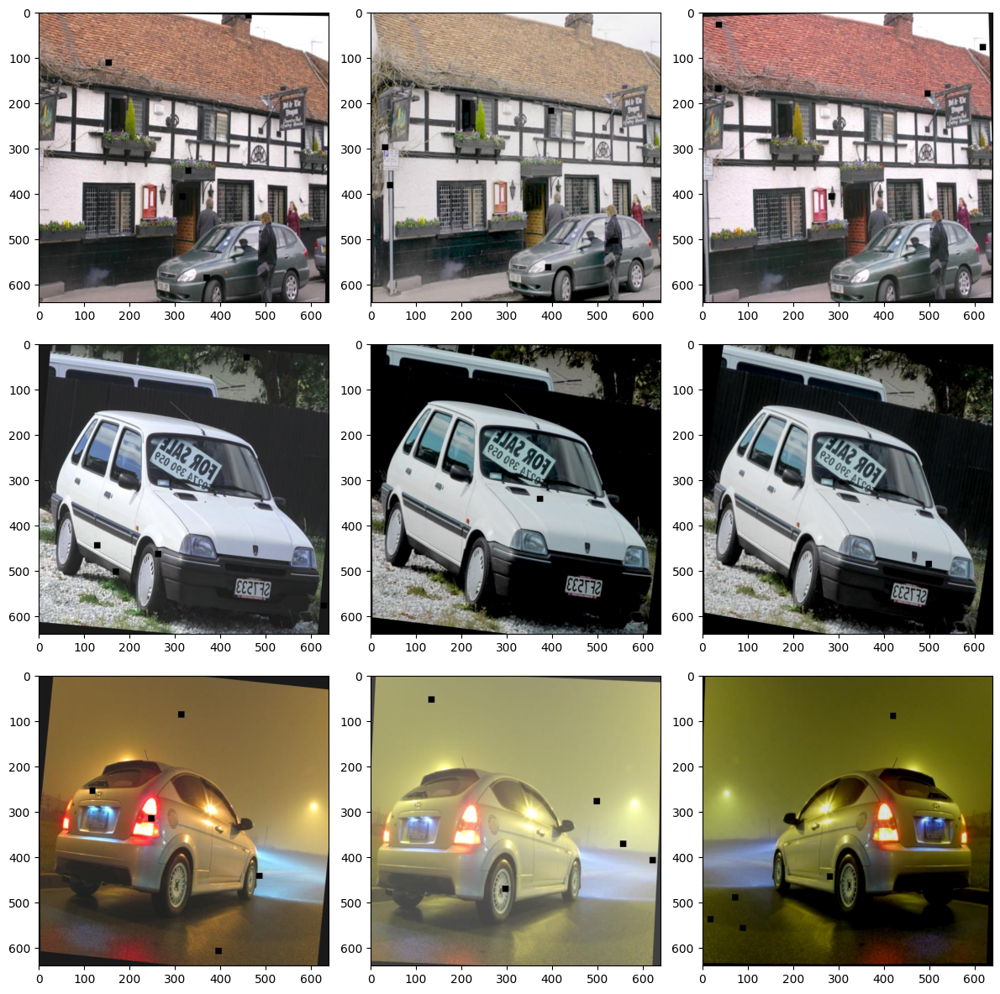

In [ ]:
import cv2
import matplotlib.pyplot as plt

train_files = [f for f in os.listdir(train_folder)]

fig, axes = plt.subplots(3, 3, figsize=(12, 12))
axes = axes.flatten()
for i in range(9):
  img_path = os.path.join(train_folder, train_files[i])
  img = cv2.imread(img_path)
  img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

  axes[i].imshow(img_rgb)
plt.tight_layout()
plt.show()

# Model

In [ ]:
import ultralytics
from ultralytics import YOLO

print(ultralytics.__version__)

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.
8.3.123


In [ ]:
model = YOLO('yolov8n.pt')

100%|██████████| 6.25M/6.25M [00:00<00:00, 96.7MB/s]


In [ ]:
model_ = YOLO('/content/best.pt')

In [ ]:
train_results = model.train(
    data="./config.yaml",
    epochs=20,
    imgsz=640,
    device='cpu'
)

Ultralytics 8.3.122  Python-3.12.4 torch-2.7.0+cpu CPU (AMD Ryzen 9 7950X 16-Core Processor)
engine\trainer: task=detect, mode=train, model=yolov8n.pt, data=./config.yaml, epochs=20, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=cpu, workers=8, project=None, name=train3, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, show_boxes=True, line_width=Non

100%|██████████| 755k/755k [00:00<00:00, 8.61MB/s]

Overriding model.yaml nc=80 with nc=1

                   from  n    params  module                                       arguments                     
  0                  -1  1       464  ultralytics.nn.modules.conv.Conv             [3, 16, 3, 2]                 
  1                  -1  1      4672  ultralytics.nn.modules.conv.Conv             [16, 32, 3, 2]                
  2                  -1  1      7360  ultralytics.nn.modules.block.C2f             [32, 32, 1, True]             
  3                  -1  1     18560  ultralytics.nn.modules.conv.Conv             [32, 64, 3, 2]                
  4                  -1  2     49664  ultralytics.nn.modules.block.C2f             [64, 64, 2, True]             
  5                  -1  1     73984  ultralytics.nn.modules.conv.Conv             [64, 128, 3, 2]               
  6                  -1  2    197632  ultralytics.nn.modules.block.C2f             [128, 128, 2, True]           
  7                  -1  1    295424  ultralytics

 22        [15, 18, 21]  1    751507  ultralytics.nn.modules.head.Detect           [1, [64, 128, 256]]           
Model summary: 129 layers, 3,011,043 parameters, 3,011,027 gradients, 8.2 GFLOPs

Transferred 319/355 items from pretrained weights
Freezing layer 'model.22.dfl.conv.weight'
train: Fast image access  (ping: 0.10.1 ms, read: 123.6135.9 MB/s, size: 43.7 KB)


train: Scanning C:\Users\wine\Giang\Code\Viet\Cell-free-new\License_Plate\License-Plate-Recognition-4\train\labels... 21173 images, 28 backgrounds, 0 corrupt: 100%|██████████| 21173/21173 [00:14<00:00, 1486.87it/s]


train: New cache created: C:\Users\wine\Giang\Code\Viet\Cell-free-new\License_Plate\License-Plate-Recognition-4\train\labels.cache
val: Fast image access  (ping: 0.00.0 ms, read: 303.4112.4 MB/s, size: 35.9 KB)


'pin_memory' argument is set as true but no accelerator is found, then device pinned memory won't be used.
val: Scanning C:\Users\wine\Giang\Code\Viet\Cell-free-new\License_Plate\License-Plate-Recognition-4\valid\labels... 2046 images, 3 backgrounds, 0 corrupt: 100%|██████████| 2046/2046 [00:01<00:00, 1363.30it/s]

val: New cache created: C:\Users\wine\Giang\Code\Viet\Cell-free-new\License_Plate\License-Plate-Recognition-4\valid\labels.cache



'pin_memory' argument is set as true but no accelerator is found, then device pinned memory won't be used.


Plotting labels to runs\detect\train3\labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.002, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
Image sizes 640 train, 640 val
Using 0 dataloader workers
Logging results to runs\detect\train3
Starting training for 20 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/20         0G      1.279      1.247      1.252          9        640: 100%|██████████| 1324/1324 [1:39:13<00:00,  4.50s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 64/64 [03:38<00:00,  3.41s/it]


                   all       2046       2132      0.951      0.878      0.941      0.594

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/20         0G      1.278     0.7951      1.264          8        640: 100%|██████████| 1324/1324 [1:17:48<00:00,  3.53s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 64/64 [01:42<00:00,  1.60s/it]

                   all       2046       2132      0.938      0.899      0.943       0.59

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



       3/20         0G      1.262     0.7516      1.259         13        640: 100%|██████████| 1324/1324 [42:15<00:00,  1.91s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 64/64 [01:42<00:00,  1.60s/it]

                   all       2046       2132      0.935      0.903      0.939      0.556

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



       4/20         0G      1.225     0.7018      1.247          9        640: 100%|██████████| 1324/1324 [43:14<00:00,  1.96s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 64/64 [01:44<00:00,  1.63s/it]

                   all       2046       2132      0.952      0.923      0.959      0.633

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



       5/20         0G      1.202     0.6624      1.229         13        640: 100%|██████████| 1324/1324 [43:45<00:00,  1.98s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 64/64 [01:50<00:00,  1.72s/it]

                   all       2046       2132       0.97      0.929      0.963       0.63

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



       6/20         0G       1.17     0.6333      1.206          7        640: 100%|██████████| 1324/1324 [44:09<00:00,  2.00s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 64/64 [01:49<00:00,  1.71s/it]

                   all       2046       2132      0.968      0.936      0.969      0.646



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/20         0G      1.159     0.6146      1.203          9        640: 100%|██████████| 1324/1324 [39:22<00:00,  1.78s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 64/64 [01:28<00:00,  1.39s/it]

                   all       2046       2132      0.951      0.936      0.967      0.656

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



       8/20         0G      1.145     0.5908      1.187         11        640: 100%|██████████| 1324/1324 [40:01<00:00,  1.81s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 64/64 [03:30<00:00,  3.28s/it]

                   all       2046       2132      0.971       0.94      0.972      0.649



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/20         0G      1.131     0.5765      1.184         10        640: 100%|██████████| 1324/1324 [1:29:52<00:00,  4.07s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 64/64 [03:44<00:00,  3.51s/it]

                   all       2046       2132      0.976      0.946      0.974      0.668



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/20         0G      1.112     0.5602      1.178         14        640: 100%|██████████| 1324/1324 [1:41:33<00:00,  4.60s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 64/64 [03:50<00:00,  3.60s/it]

                   all       2046       2132      0.972      0.949      0.973      0.667


Closing dataloader mosaic

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


'pin_memory' argument is set as true but no accelerator is found, then device pinned memory won't be used.
      11/20         0G      1.094     0.4784      1.202          5        640: 100%|██████████| 1324/1324 [1:33:31<00:00,  4.24s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 64/64 [03:16<00:00,  3.07s/it]

                   all       2046       2132      0.974      0.946      0.977      0.668



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/20         0G      1.074     0.4619      1.193          6        640: 100%|██████████| 1324/1324 [1:31:09<00:00,  4.13s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 64/64 [03:08<00:00,  2.95s/it]

                   all       2046       2132      0.975      0.945      0.974      0.676



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/20         0G      1.057     0.4447      1.186          5        640: 100%|██████████| 1324/1324 [1:33:47<00:00,  4.25s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 64/64 [03:21<00:00,  3.14s/it]

                   all       2046       2132      0.981       0.94      0.976      0.679



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/20         0G      1.043     0.4325      1.178          5        640: 100%|██████████| 1324/1324 [1:38:00<00:00,  4.44s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 64/64 [03:30<00:00,  3.29s/it]

                   all       2046       2132      0.974      0.951      0.979      0.685



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/20         0G      1.027     0.4194      1.171          5        640: 100%|██████████| 1324/1324 [1:29:18<00:00,  4.05s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 64/64 [02:52<00:00,  2.69s/it]

                   all       2046       2132      0.974      0.955      0.982      0.689



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/20         0G      1.014     0.4066      1.159          6        640: 100%|██████████| 1324/1324 [1:26:23<00:00,  3.91s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 64/64 [03:50<00:00,  3.59s/it]

                   all       2046       2132      0.976      0.953      0.981      0.694



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/20         0G     0.9995     0.3962       1.15          5        640: 100%|██████████| 1324/1324 [1:37:15<00:00,  4.41s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 64/64 [03:35<00:00,  3.36s/it]

                   all       2046       2132      0.983      0.949      0.982      0.694



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/20         0G     0.9836     0.3863       1.14          5        640: 100%|██████████| 1324/1324 [1:25:59<00:00,  3.90s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 64/64 [03:42<00:00,  3.48s/it]

                   all       2046       2132      0.984      0.955      0.984      0.697



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/20         0G     0.9727     0.3744      1.132         10        640: 100%|██████████| 1324/1324 [1:29:26<00:00,  4.05s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 64/64 [03:03<00:00,  2.87s/it]

                   all       2046       2132      0.986      0.952      0.984      0.701



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/20         0G     0.9588     0.3666      1.126          5        640: 100%|██████████| 1324/1324 [1:30:39<00:00,  4.11s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 64/64 [03:42<00:00,  3.48s/it]

                   all       2046       2132      0.985      0.952      0.983      0.703



20 epochs completed in 26.600 hours.
Optimizer stripped from runs\detect\train3\weights\last.pt, 6.2MB
Optimizer stripped from runs\detect\train3\weights\best.pt, 6.2MB

Validating runs\detect\train3\weights\best.pt...
Ultralytics 8.3.122  Python-3.12.4 torch-2.7.0+cpu CPU (AMD Ryzen 9 7950X 16-Core Processor)
Model summary (fused): 72 layers, 3,005,843 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 64/64 [02:34<00:00,  2.41s/it]


                   all       2046       2132      0.985      0.952      0.983      0.703
Speed: 2.0ms preprocess, 65.5ms inference, 0.0ms loss, 0.4ms postprocess per image
Results saved to runs\detect\train3


In [ ]:
import cv2


cap = cv2.VideoCapture('/content/sample.mp4')

if not cap.isOpened():
  print("Error: Could not open video")
  exit()

while cap.isOpened():
  ret, frame = cap.read()
  if not ret:
    break

  results = model(frame)

  for result in results:
     frame = result.render()[0]

  cv2.imshow('YOLOv8 Object Detection', frame)

  if cv2.waitKey(1) & 0xFF == ord('q'):
    break

cap.release()


0: 384x640 21 cars, 1 bus, 2 trucks, 249.9ms
Speed: 7.4ms preprocess, 249.9ms inference, 2.4ms postprocess per image at shape (1, 3, 384, 640)


AttributeError: 'Results' object has no attribute 'render'. See valid attributes below.

    A class for storing and manipulating inference results.

    This class provides methods for accessing, manipulating, and visualizing inference results from various
    Ultralytics models, including detection, segmentation, classification, and pose estimation.

    Attributes:
        orig_img (numpy.ndarray): The original image as a numpy array.
        orig_shape (Tuple[int, int]): Original image shape in (height, width) format.
        boxes (Boxes | None): Detected bounding boxes.
        masks (Masks | None): Segmentation masks.
        probs (Probs | None): Classification probabilities.
        keypoints (Keypoints | None): Detected keypoints.
        obb (OBB | None): Oriented bounding boxes.
        speed (dict): Dictionary containing inference speed information.
        names (dict): Dictionary mapping class indices to class names.
        path (str): Path to the input image file.
        save_dir (str | None): Directory to save results.

    Methods:
        update: Updates the Results object with new detection data.
        cpu: Returns a copy of the Results object with all tensors moved to CPU memory.
        numpy: Converts all tensors in the Results object to numpy arrays.
        cuda: Moves all tensors in the Results object to GPU memory.
        to: Moves all tensors to the specified device and dtype.
        new: Creates a new Results object with the same image, path, names, and speed attributes.
        plot: Plots detection results on an input RGB image.
        show: Displays the image with annotated inference results.
        save: Saves annotated inference results image to file.
        verbose: Returns a log string for each task in the results.
        save_txt: Saves detection results to a text file.
        save_crop: Saves cropped detection images to specified directory.
        summary: Converts inference results to a summarized dictionary.
        to_df: Converts detection results to a Pandas Dataframe.
        to_json: Converts detection results to JSON format.
        to_csv: Converts detection results to a CSV format.
        to_xml: Converts detection results to XML format.
        to_html: Converts detection results to HTML format.
        to_sql: Converts detection results to an SQL-compatible format.

    Examples:
        >>> results = model("path/to/image.jpg")
        >>> result = results[0]  # Get the first result
        >>> boxes = result.boxes  # Get the boxes for the first result
        >>> masks = result.masks  # Get the masks for the first result
        >>> for result in results:
        >>>     result.plot()  # Plot detection results
    

In [ ]:
def get_car(license_plate, track_ids):
  x1, y1, x2, y2, _, _ = license_plate

  foundIt = False

  for j in range(len(track_ids)):
    xcar1, ycar1, xcar2, ycar2, car_id = track_ids[j]

    if x1 > xcar1 and x2 < xcar2 and y1 > ycar1 and y2 < ycar2:
      foundIt = True
      break

  if foundIt:
    return x1, y1, x2, y2, car_id

  return -1, -1, -1, -1, -1


0: 384x640 21 cars, 1 bus, 2 trucks, 225.3ms
Speed: 4.6ms preprocess, 225.3ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 21 cars, 1 bus, 2 trucks, 207.1ms
Speed: 4.5ms preprocess, 207.1ms inference, 2.2ms postprocess per image at shape (1, 3, 384, 640)


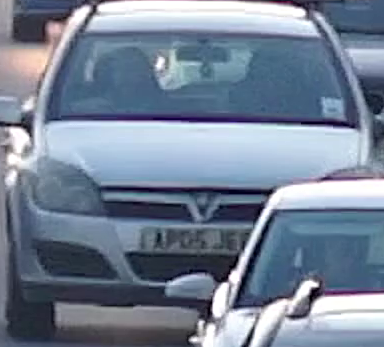

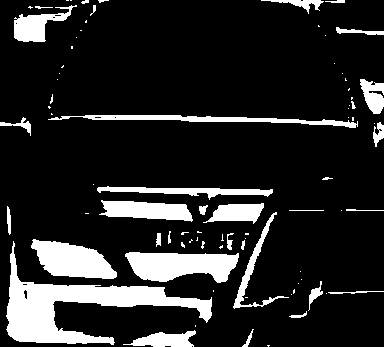

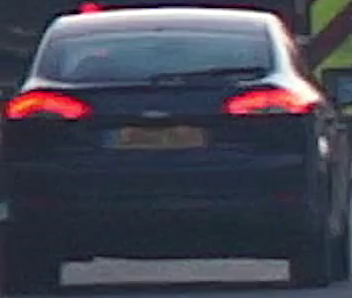

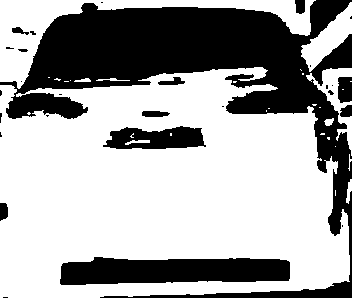

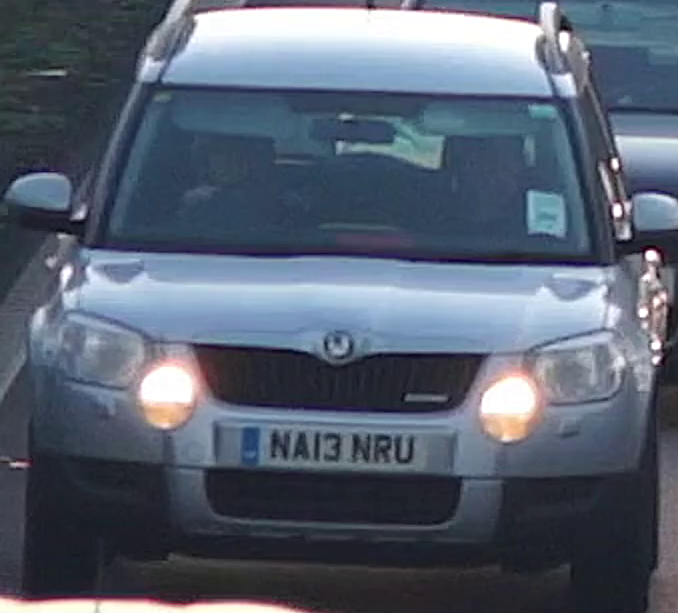

...

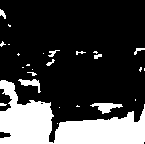

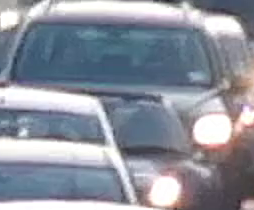

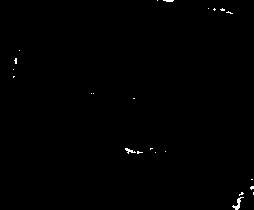

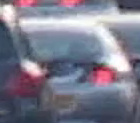

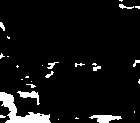


0: 384x640 21 cars, 1 bus, 2 trucks, 347.1ms
Speed: 10.5ms preprocess, 347.1ms inference, 3.0ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 21 cars, 1 bus, 2 trucks, 203.7ms
Speed: 4.7ms preprocess, 203.7ms inference, 2.1ms postprocess per image at shape (1, 3, 384, 640)


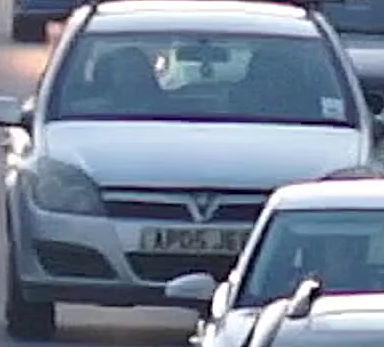

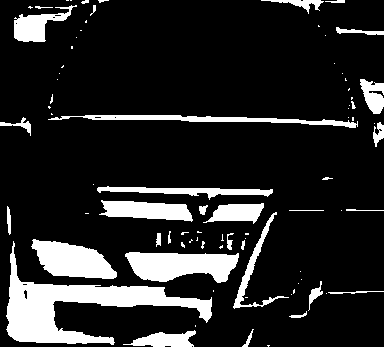

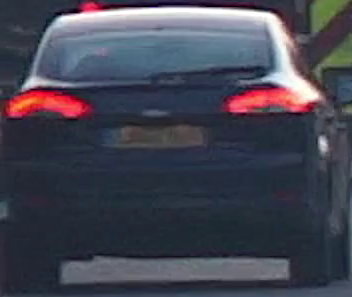

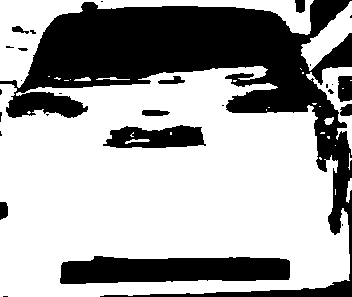

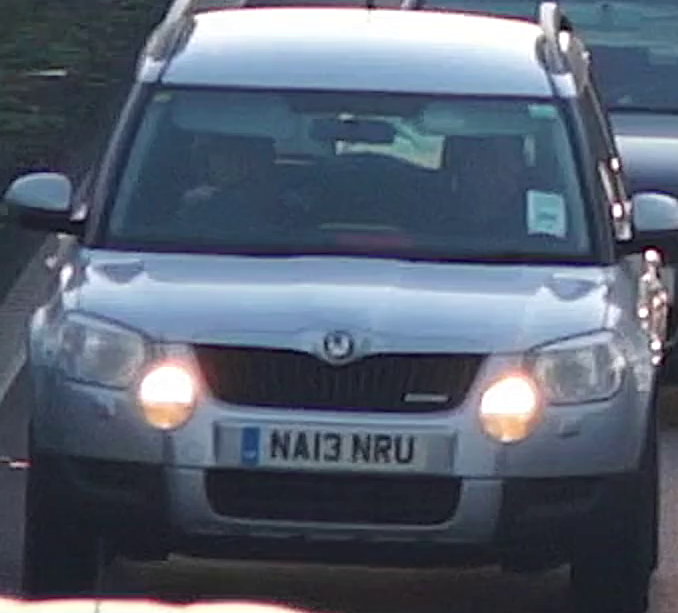

...

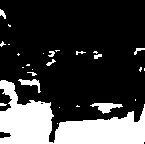

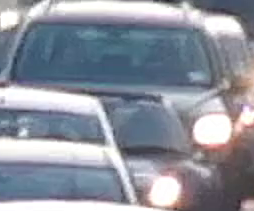

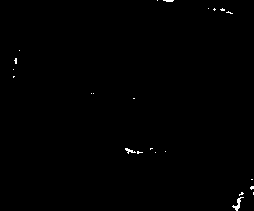

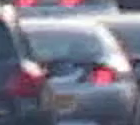

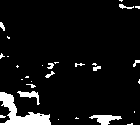


0: 384x640 22 cars, 1 bus, 2 trucks, 251.9ms
Speed: 7.4ms preprocess, 251.9ms inference, 2.2ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 22 cars, 1 bus, 2 trucks, 217.3ms
Speed: 5.1ms preprocess, 217.3ms inference, 3.3ms postprocess per image at shape (1, 3, 384, 640)


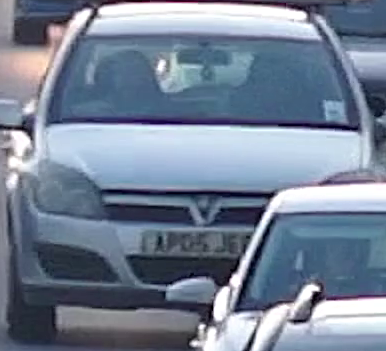

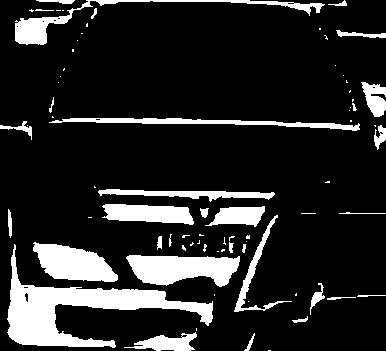

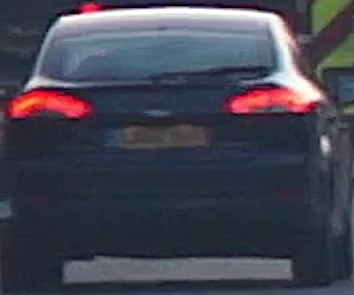

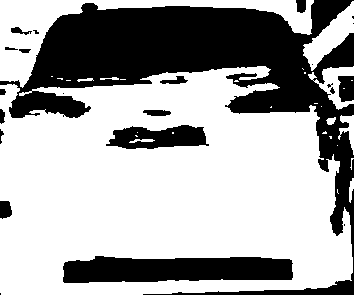

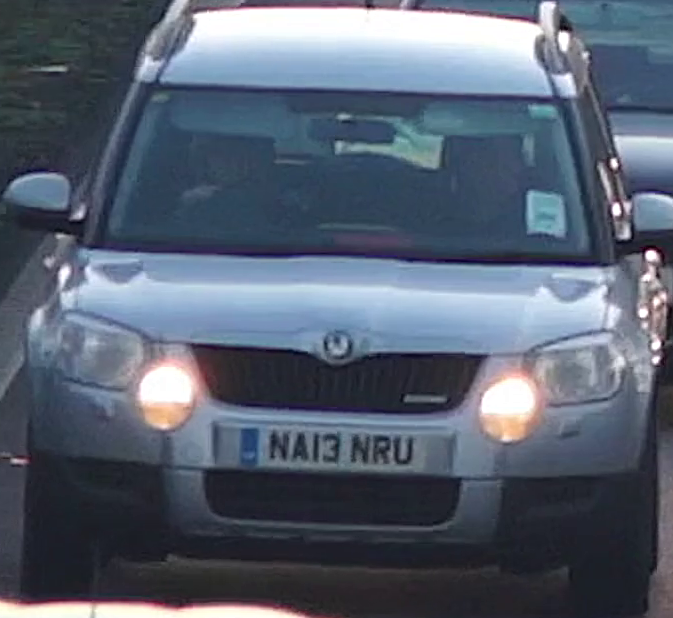

...

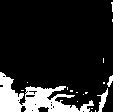

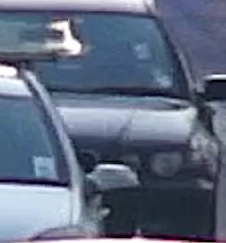

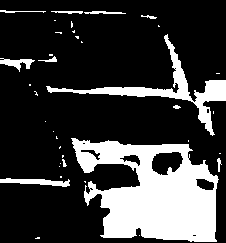

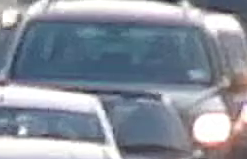

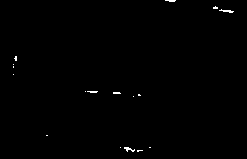


0: 384x640 21 cars, 1 bus, 2 trucks, 252.5ms
Speed: 5.3ms preprocess, 252.5ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 21 cars, 1 bus, 2 trucks, 239.5ms
Speed: 4.9ms preprocess, 239.5ms inference, 2.1ms postprocess per image at shape (1, 3, 384, 640)


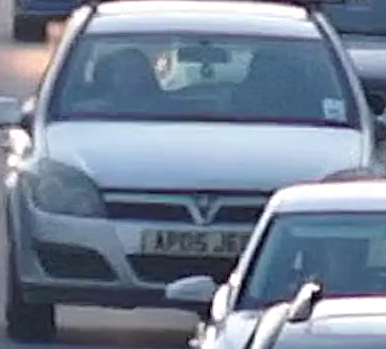

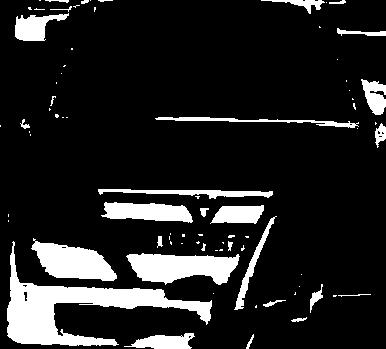

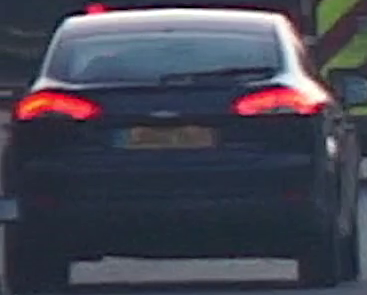

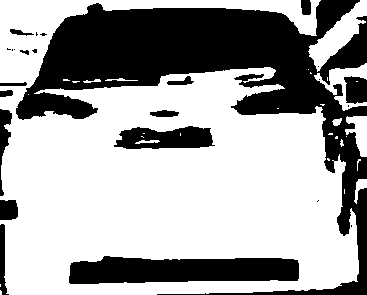

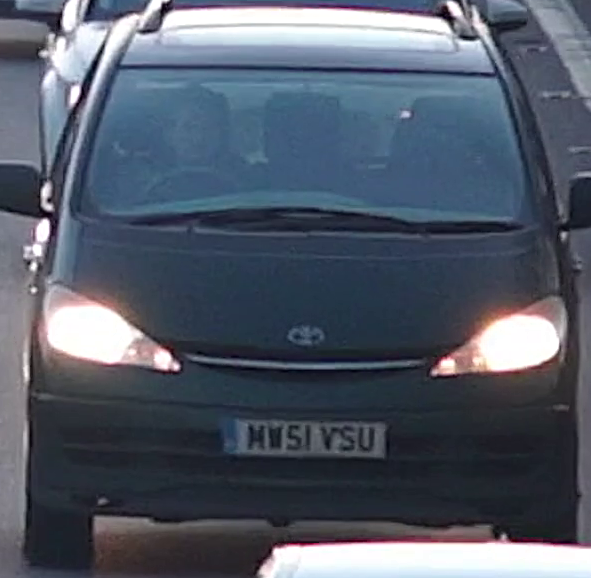

...

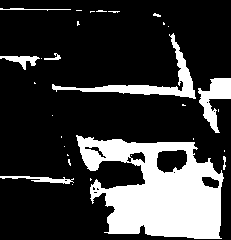

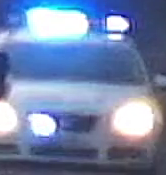

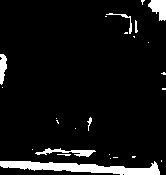

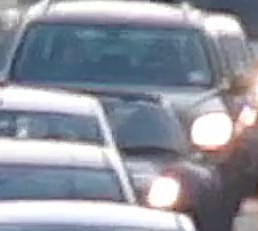

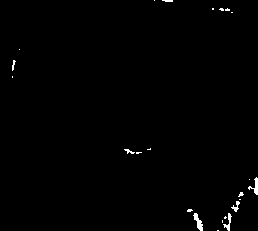


0: 384x640 22 cars, 1 bus, 2 trucks, 282.7ms
Speed: 10.4ms preprocess, 282.7ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 22 cars, 1 bus, 2 trucks, 221.2ms
Speed: 4.8ms preprocess, 221.2ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)


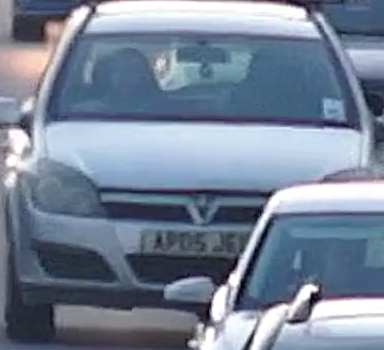

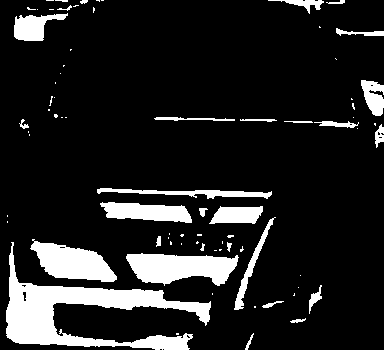

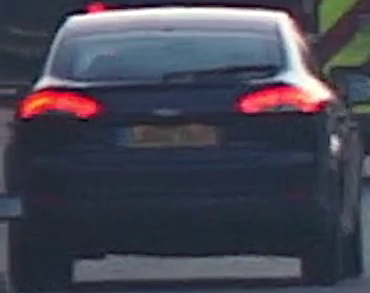

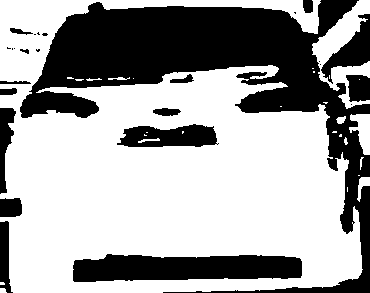

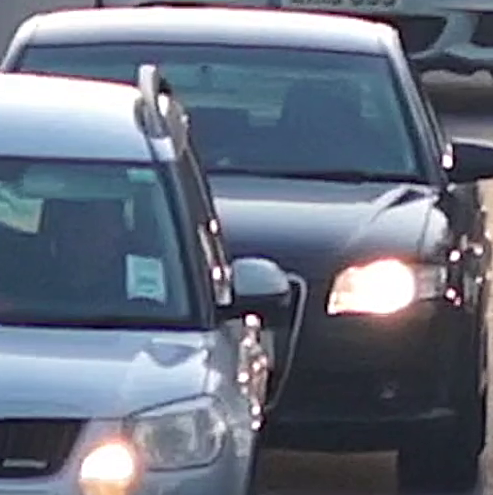

...

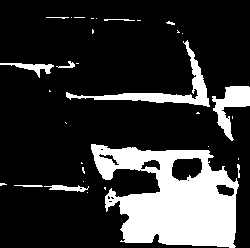

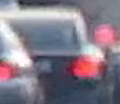

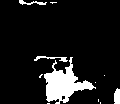

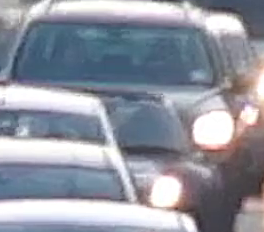

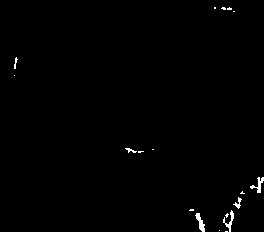


0: 384x640 25 cars, 1 bus, 2 trucks, 213.9ms
Speed: 5.0ms preprocess, 213.9ms inference, 2.1ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 25 cars, 1 bus, 2 trucks, 207.2ms
Speed: 7.5ms preprocess, 207.2ms inference, 2.1ms postprocess per image at shape (1, 3, 384, 640)


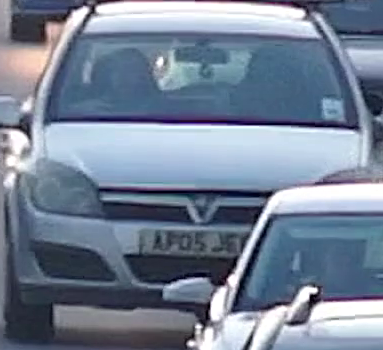

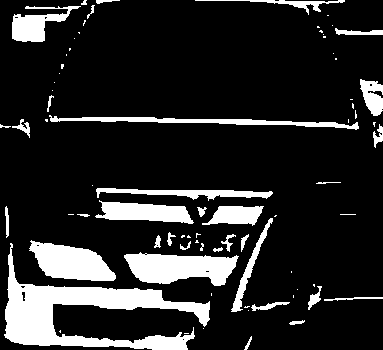

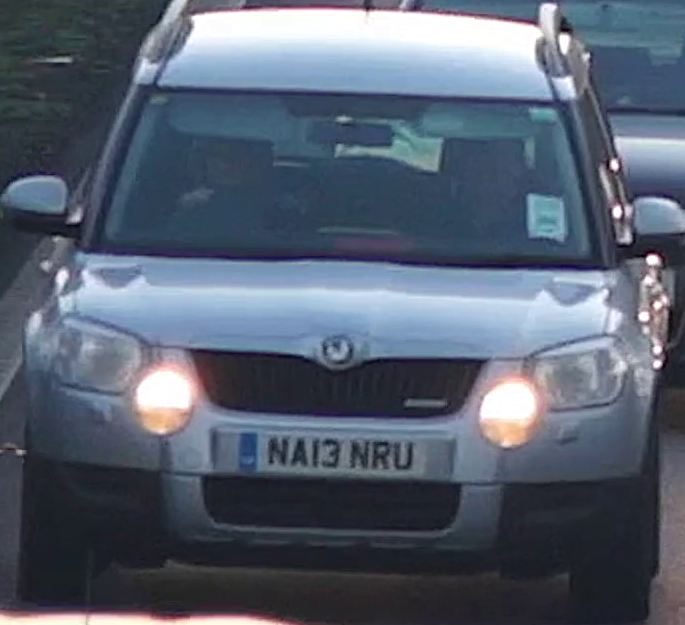

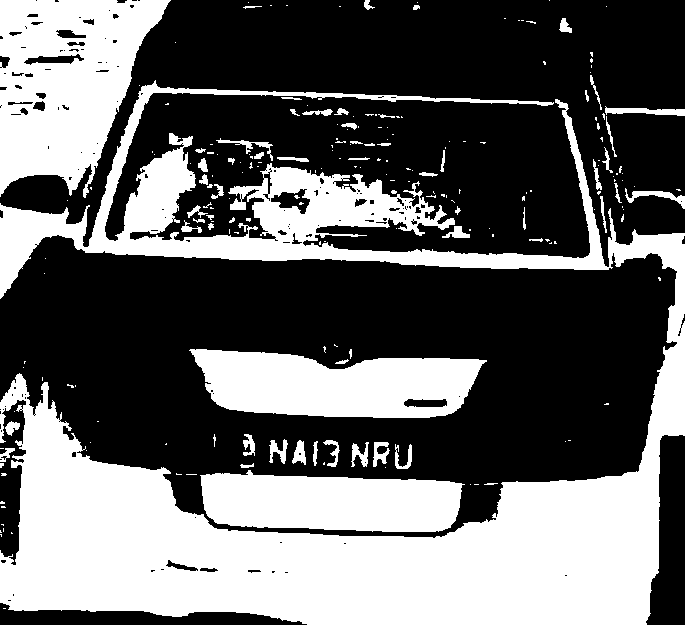

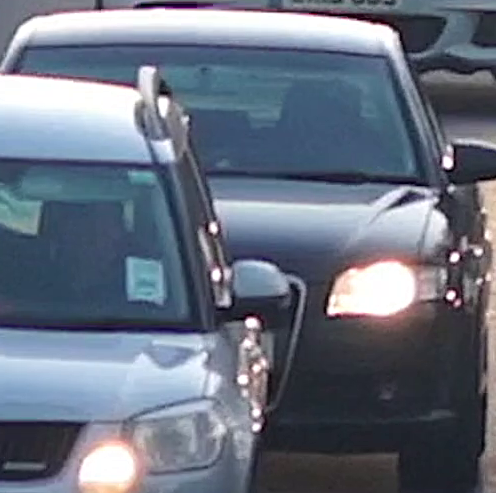

...

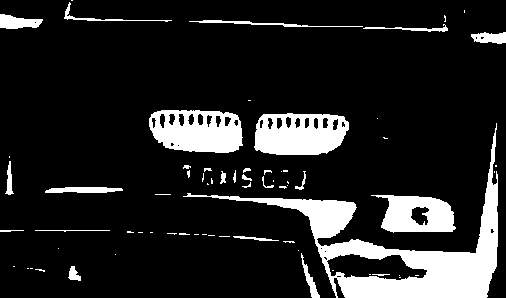

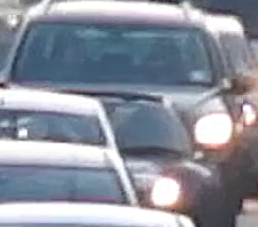

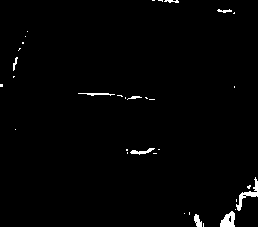

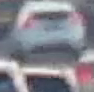

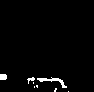


0: 384x640 23 cars, 1 bus, 1 truck, 295.3ms
Speed: 4.6ms preprocess, 295.3ms inference, 2.2ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 23 cars, 1 bus, 1 truck, 210.8ms
Speed: 4.9ms preprocess, 210.8ms inference, 2.4ms postprocess per image at shape (1, 3, 384, 640)


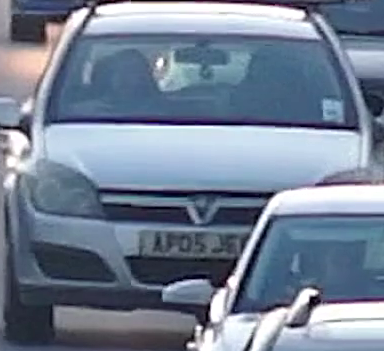

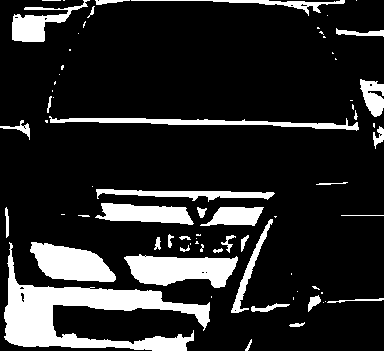

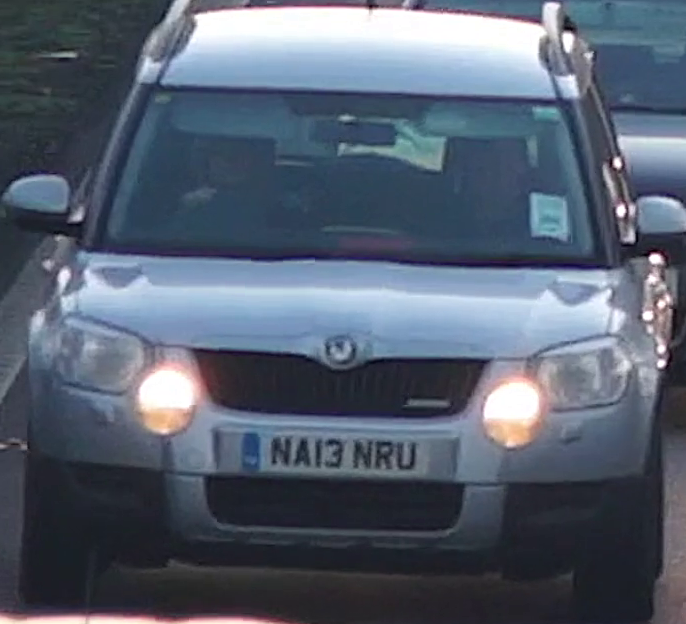

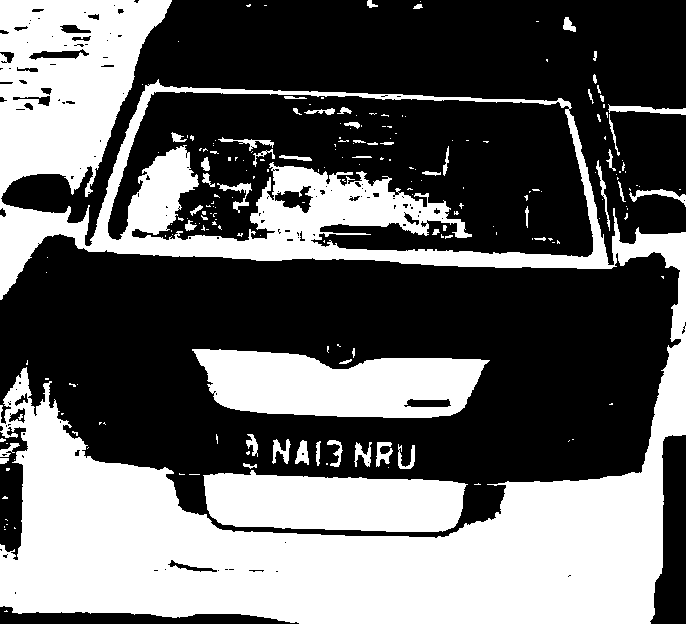

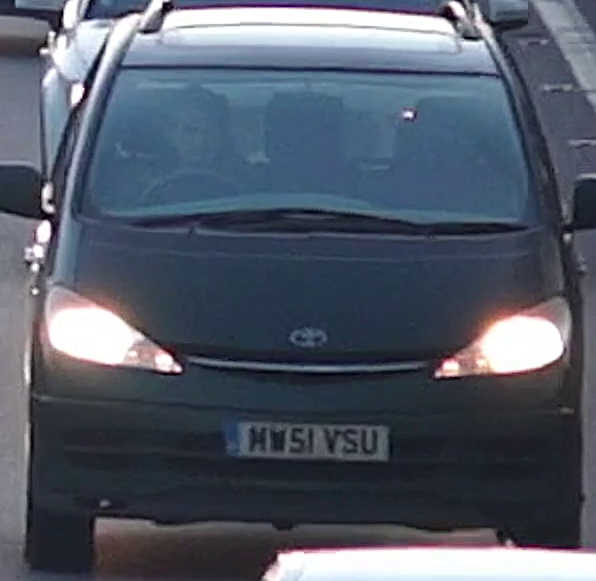

...

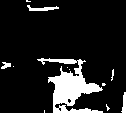

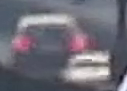

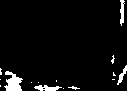

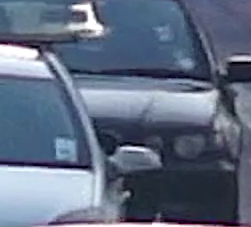

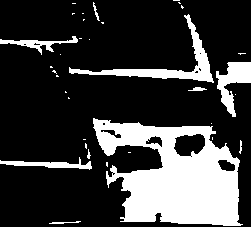


0: 384x640 23 cars, 1 bus, 1 truck, 237.4ms
Speed: 4.7ms preprocess, 237.4ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 23 cars, 1 bus, 1 truck, 199.4ms
Speed: 4.3ms preprocess, 199.4ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)


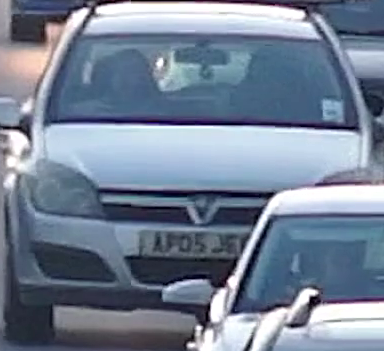

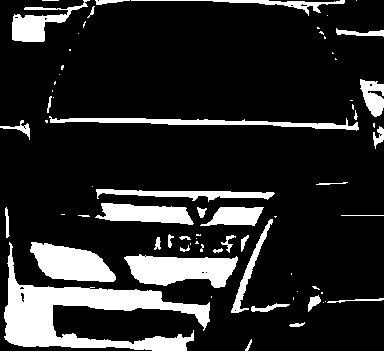

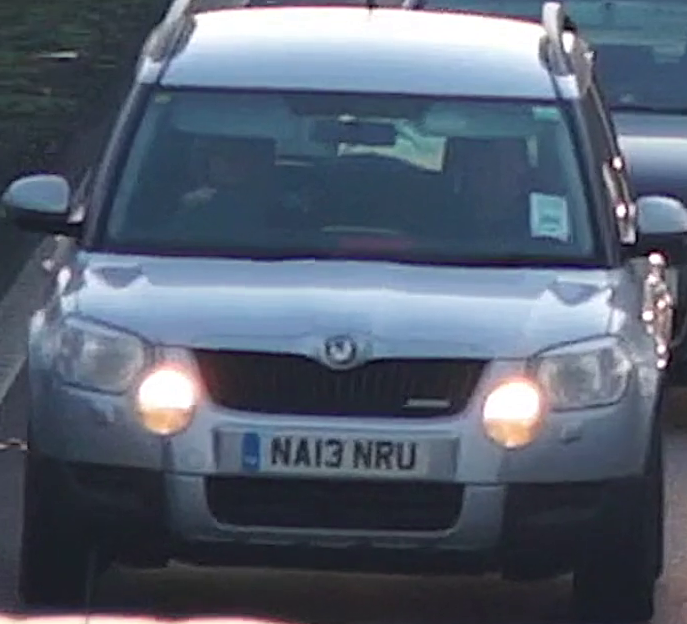

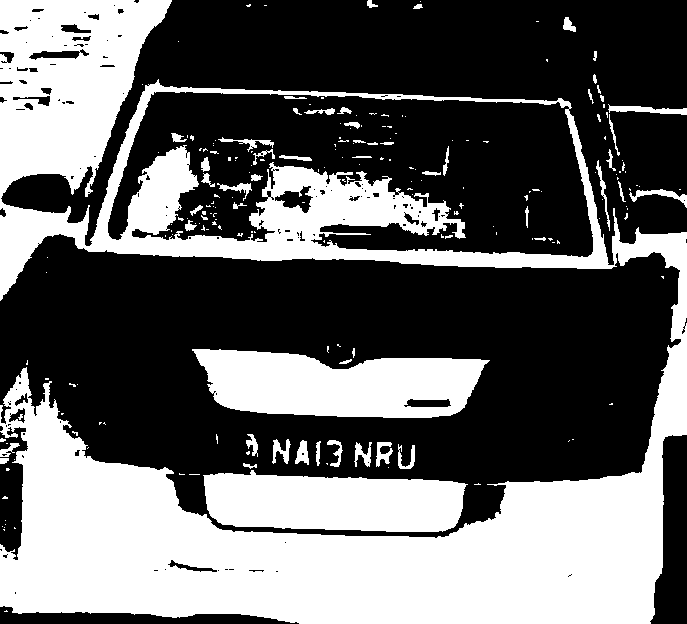

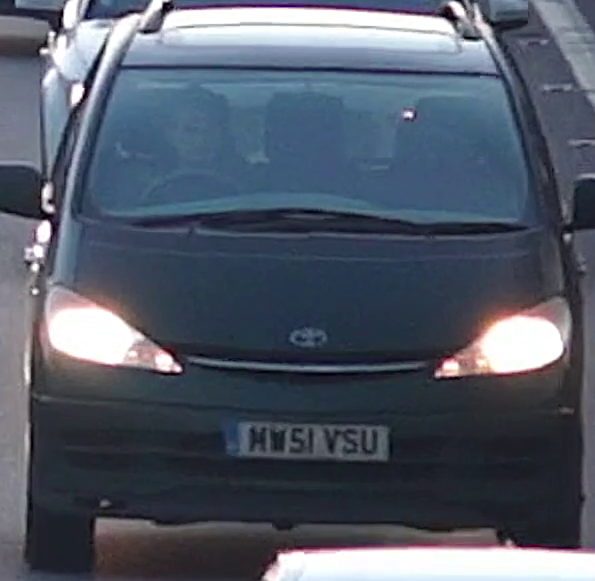

...

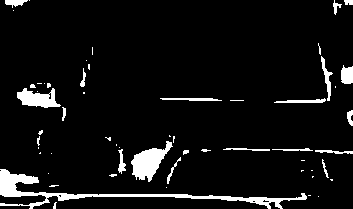

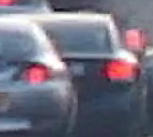

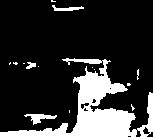

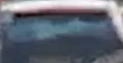

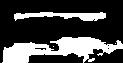

In [ ]:
import cv2
from sort.sort import *
import numpy as np
from google.colab.patches import cv2_imshow

coco_model = YOLO('yolov8n.pt')
mot_tracker = Sort()
cap = cv2.VideoCapture('/content/sample.mp4')
vehicles = [2, 3, 5, 7]

frame_nmr = -1
ret = True
while ret:
  frame_nmr += 1
  ret, frame = cap.read()
  if ret and frame_nmr < 10:
    detections = coco_model(frame)[0]
    # print(detections)
    detections_ = []
    for detection in detections.boxes.data.tolist():
      x1, y1, x2, y2, score, class_id = detection
      if int(class_id) in vehicles:
        detections_.append([x1, y1, x2, y2, score])
    # track vehicles
    track_ids =  mot_tracker.update(np.asarray(detections_))

    # detect license plates in vehicles
    license_plates = model(frame)[0]
    for license_plate in license_plates.boxes.data.tolist():
      x1, y1, x2, y2, score, class_id = license_plate

      xcar1, ycar1, xcar2, ycar2, car_id =  get_car(license_plate, track_ids)
      license_plate_crop = frame[int(y1):int(y2), int(x1):int(x2),:]

      license_plate_crop_gray =  cv2.cvtColor(license_plate_crop, cv2.COLOR_BGR2GRAY)
      _, license_plate_crop_thresh =  cv2.threshold(license_plate_crop_gray, 64, 255, cv2.THRESH_BINARY_INV)

      cv2_imshow(license_plate_crop)
      cv2_imshow( license_plate_crop_thresh)
      # cv2.waitKey(0)